In [4]:
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm
from sklearn.cluster import KMeans
import torch
import torch.nn as nn
from torch.utils.data import DataLoader

import os
import sys

sys.path.append("../scripts")
import data
import models

# autoreload
%load_ext autoreload
%autoreload 2

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [2]:
filenames = data.get_filenames_center_blocks()

In [5]:
dataset = data.SmallPatchesDataset(filenames, resize = (224, 224))
dataloader = DataLoader(dataset, batch_size = 300, shuffle = False)

In [8]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
model = models.AutoEncoderResnetExtractor(128)
model.load_state_dict(torch.load("../models/AE_extractor_resnet50_small_128/model.pt"))
model.to(device);

In [15]:
def plot_sample(sample, ax = None):
    img = sample
    img = img.permute(1, 2, 0).detach().cpu().numpy()
    if ax is None:
        plt.imshow(img)
        plt.axis(False)
        plt.show()
    else:
        ax.imshow(img)

In [10]:
def get_embeddings(model, dl):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)
    model.eval()
    embeddings = []
    with torch.no_grad():
        for batch in tqdm(dl):
            batch = batch.to(device)
            z = model.encoder(batch).detach().cpu().numpy()
            embeddings.append(z)
    embeddings = np.concatenate(embeddings)
    return embeddings

In [12]:
embeddings = get_embeddings(model, dataloader)

  0%|          | 0/1789 [00:00<?, ?it/s]/home/giovani/miniconda3/envs/urban_gdp/lib/python3.9/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(
100%|██████████| 1789/1789 [32:54<00:00,  1.10s/it]


In [19]:
def visualize_cluster_samples(k, clusters, n_samples = 9):
    ncols = 5
    nrows = k // 5 + (k % 5 > 0)
    fig, axs = plt.subplots(nrows = nrows, ncols = ncols, figsize = (ncols * 4, nrows * 4))
    axs = axs.flat
    [ax.set_axis_off() for ax in axs]

    for i in range(k):
        axs[i].set_title(f"Samples of cluster {i}")
        samples = clusters == i
        if samples.sum() == 0:
            continue
        
        random_sample = np.random.choice(np.where(samples)[0], min(n_samples, samples.sum()))
        samples_per_row = int(np.sqrt(n_samples))
        img = torch.zeros((3, 224 * samples_per_row, 224 *samples_per_row))
        for j, idx in enumerate(random_sample):
            img[:, (j // samples_per_row) * 224: (j // samples_per_row + 1) * 224, (j % samples_per_row) * 224: (j % samples_per_row + 1) * 224] = dataset[idx]

        plot_sample(img, axs[i])
    plt.suptitle(f"Samples with k = {k}")


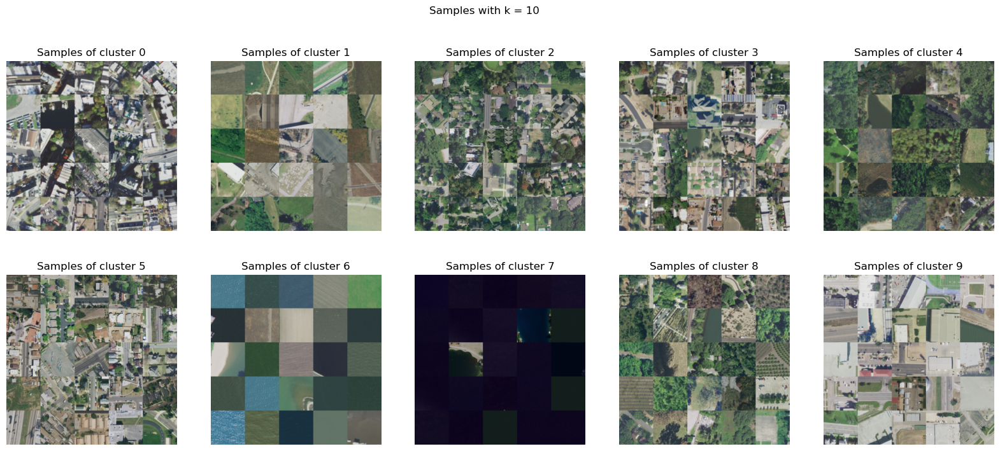

In [20]:
k = 10
kmeans = KMeans(n_clusters = k, random_state = 0).fit(embeddings)
clusters = kmeans.labels_
visualize_cluster_samples(k, clusters, 25)

/home/giovani/miniconda3/envs/urban_gdp/lib/python3.9/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/home/giovani/miniconda3/envs/urban_gdp/lib/python3.9/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.wa

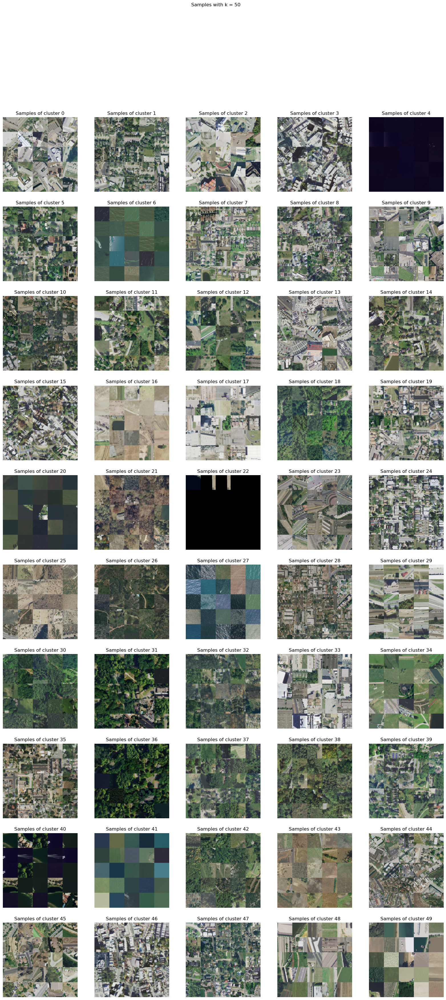

In [21]:
k = 50
kmeans = KMeans(n_clusters = k, random_state = 0).fit(embeddings)
clusters = kmeans.labels_
visualize_cluster_samples(k, clusters, 25)

/home/giovani/miniconda3/envs/urban_gdp/lib/python3.9/site-packages/torchvision/transforms/functional.py:1603: UserWarning: The default value of the antialias parameter of all the resizing transforms (Resize(), RandomResizedCrop(), etc.) will change from None to True in v0.17, in order to be consistent across the PIL and Tensor backends. To suppress this warning, directly pass antialias=True (recommended, future default), antialias=None (current default, which means False for Tensors and True for PIL), or antialias=False (only works on Tensors - PIL will still use antialiasing). This also applies if you are using the inference transforms from the models weights: update the call to weights.transforms(antialias=True).
  warnings.warn(


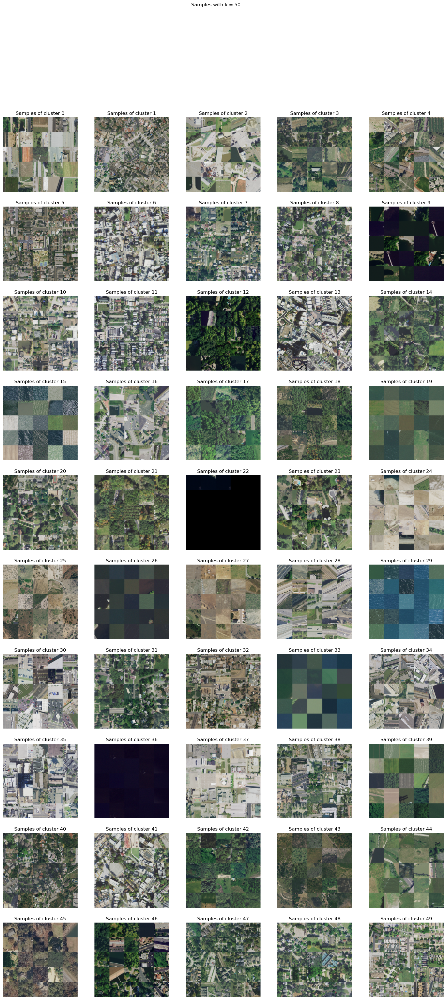

In [22]:
k = 50
kmeans = KMeans(n_clusters = k, random_state = 0, n_init=20).fit(embeddings)
clusters = kmeans.labels_
visualize_cluster_samples(k, clusters, 25)